In [31]:
import collections
import sys
from pathlib import Path

import matplotlib.pyplot as plt
import matplotlib.transforms as mtrans
import matplotlib.patches as mpatches
import numpy as np
import pandas as pd
from skimage import exposure
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
import cv2
fontprops = fm.FontProperties(size=34)
from sklearn.neighbors import NearestNeighbors
from skimage import color, measure, filters
import seaborn as sns
from matplotlib.colors import ListedColormap
import os
import skimage
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from skimage import filters
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import ImageGrid
from skimage.filters import gaussian
from skimage.filters.rank import median
from skimage.morphology import disk, ball
import networkx as nx

import scipy.cluster.hierarchy as sch


%load_ext autoreload
%autoreload 2

# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = str(Path.cwd().parents[0] / "src")
if module_path not in sys.path:
    sys.path.append(module_path)
    

from config import *
import my_io as io

# Import metadata information

df_metadata = pd.read_csv(data_dir / 'metadata.csv')
df_metadata.head()

datasets = df_metadata.Directory.to_list()
datasets = [name.split('\\')[-1] for name in datasets]

datasets = ['ROI001_B1',
            'ROI021_E7',
            'ROI017_F2',
            'ROI008_D7',
            'ROI012_E1',
            'ROI016_F3'
           ]

Immune_type = ['Immune Cold', 'Immune Cold', 'Immune Suppressed', 'Immune Suppressed', 'Immune inflamed', 'Immune inflamed']

print(datasets)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
['ROI001_B1', 'ROI021_E7', 'ROI017_F2', 'ROI008_D7', 'ROI012_E1', 'ROI016_F3']


# Get cell type

In [32]:
def read_cell_mask(ROI: str):
    """Read all image from one ROI"""
    dir_ = data_figure / 'mask_DL'

    # Get images in directory
    dirpath, _, filenames = next(os.walk(dir_))
    for name in filenames:
        if 'both' in name:
            continue
        elif ROI in name and 'cyto' in name:
            mask_name = name
    mask = skimage.io.imread(os.path.join(dirpath, mask_name))
    return mask

def get_cell_expression_level_mean(imgs_list, labels, cell_mask):
    # Multiple each cell region by mean intensity 
    df_list = []
    for idx, img in enumerate(imgs_list):
        exp_prop = pd.DataFrame(measure.regionprops_table(cell_mask, img, properties=['label','mean_intensity'])).set_index('label')

        df = exp_prop.rename(columns = {'mean_intensity': labels[idx]}, errors = 'raise')
        df_list.append(df)
    df_exp = pd.concat(df_list, axis=1)
    return df_exp

def get_cell_color(df, labels, rgb):

    label2num = dict(zip(labels, [i for i in range(len(labels))]))
    num2color = dict([(i, rgb[i]/255) for i in range(len(labels))])
    
    df_immune = df.copy()
    df_subset = df_immune.iloc[:, :4]
    df_immune.loc[
        (df_subset.idxmax(axis=1) == 'ECA+PanK') | 
        (df_subset.idxmax(axis=1) == 'Col1+SMA'), 
        labels[-1] # last element labels is study marker
    ] = 0 
    df_immune.drop(['CD8a', 'CD68'], axis=1, inplace=True)
    
    cell_max_marker = df_immune.idxmax(axis=1)
    cell_max_marker = cell_max_marker.apply(label2num.get)
    
    cell_max_color = cell_max_marker.apply(num2color.get)
    
    return cell_max_marker.to_dict(), cell_max_color.values

def replace_with_dict(ar, dic):
    new_dict = dic.copy()
    new_dict[0] = np.nan
    
    # Extract out keys and values
    k = np.array(list(new_dict.keys()))
    v = np.array(list(new_dict.values()))

    # Get argsort indices
    sidx = k.argsort()

    ks = k[sidx]
    vs = v[sidx]
    return vs[np.searchsorted(ks,ar)]

def myround(x, base=5):
    return base * round(x/base)

def get_distances(cell_mask, r=30):
    # NN classifier
    neigh = NearestNeighbors(radius=r)
    
    # Get centroid of cellmask
    prop = measure.regionprops_table(cell_mask, properties=['label',"centroid"])
    X = np.column_stack((prop["centroid-0"], prop["centroid-1"]))
    
    # fit the k-NN classifier
    neigh.fit(X)
    distances, neighbors = neigh.radius_neighbors(X, return_distance=True, sort_results=True)
    graph = neigh.radius_neighbors_graph(X, mode='distance').toarray()
    return distances, neighbors, prop['label'], graph, X

def plot_nn(X, graph, node_colors, ax):
    G = nx.from_numpy_array(graph)
    pos = dict(zip(np.arange(len(X)), X[:,[1,0]]))
    nx.draw(G, pos, node_size=20, node_color=node_colors, edge_color='sandybrown', linewidths=2, ax=ax)

In [33]:
from collections import defaultdict
from numpy.lib.stride_tricks import as_strided

def get_nei_info(cell_labels, neighbors, node_class, distances):
    node_nei_info = defaultdict(dict)
    for idx, node in enumerate(cell_labels):
        neighbor = neighbors[idx][1:]
        nei_class = np.array([node_class[cell_labels[n]] for n in neighbor])
        nei_distance = distances[idx][1:]   # First distance always correspond to 0 for item itself

        unique, counts = np.unique(nei_class, return_counts=True)
        for idx, c in enumerate(unique):
            node_nei_info[node][c] = {
                'count': counts[idx], 
                'avg_distance': np.mean(nei_distance[np.where(nei_class == c)])
            }
    return node_nei_info
                             
def get_node_patch(X, node_class, n):
    nodes = node_class.keys()
    patches = X//n
    return dict(zip(nodes, patches))

def tile_array(a, b0, b1):
    r, c = a.shape                                    # number of rows/columns
    rs, cs = a.strides                                # row/column strides 
    x = as_strided(a, (r, b0, c, b1), (rs, 0, cs, 0)) # view a as larger 4D array
    return x.reshape(r*b0, c*b1)                      # create new 2D array

def patch_count(c, node_class, node_patch, n, shape):
    matching_node = [k for k, v in node_class.items() if v == c]
    patch_matrix = np.zeros(tuple(d//n for d in shape))
    for node in matching_node:
        i, j = node_patch[node]
        i = int(i)
        j = int(j)
        patch_matrix[i][j] += 1
    patch_matrix = patch_matrix
    return patch_matrix

def patch_count_neighbor(c1, c2, neighbor_class, node_class, node_patch, n, shape):
    patch_matrix = np.zeros(tuple(d//n for d in shape))
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            i, j = node_patch[node]
            i = int(i)
            j = int(j)
            patch_matrix[i][j] += neighbors.get(c2)['count']
    patch_matrix = patch_matrix
    return patch_matrix

def count_neighbor(c1, c2, neighbor_class, node_class):
    count = 0
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            count += neighbors.get(c2)['count']
    return count

def plot_count_patch(node_class, node_patch, n, shape, path=None):
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count(c, node_class, node_patch, n, shape))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = 'RdYlBu_r', norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Count')
    if path:
         fig.savefig(path, bbox_inches='tight')
    
def plot_interaction_patch(init_c, node_class, node_patch, n, shape, cmap, path=None):
    init_c = 0
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count_neighbor(init_c, c, neighbor_class, node_patch, n, shape))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = cmap, norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Count')
    if path:
         fig.savefig(path, bbox_inches='tight')

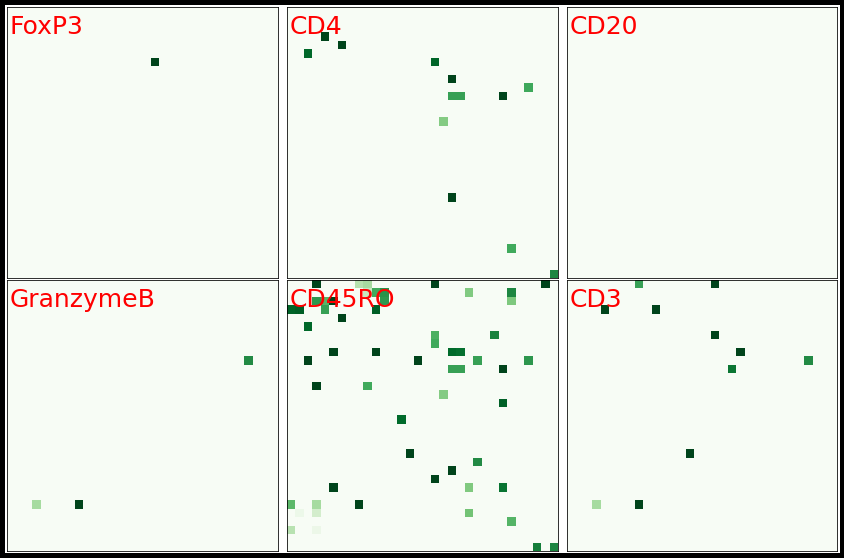

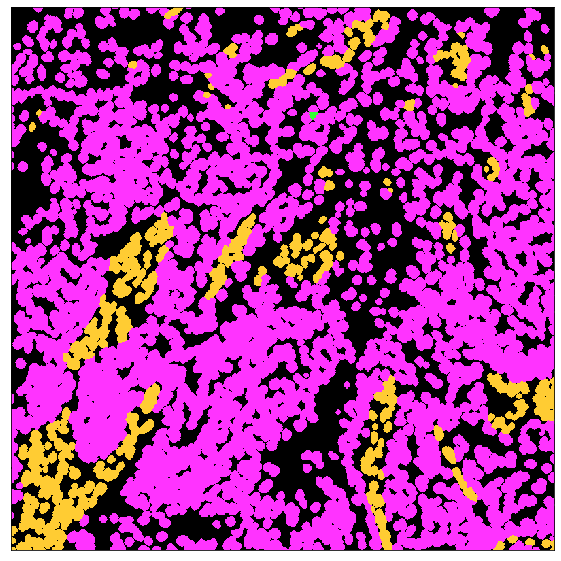

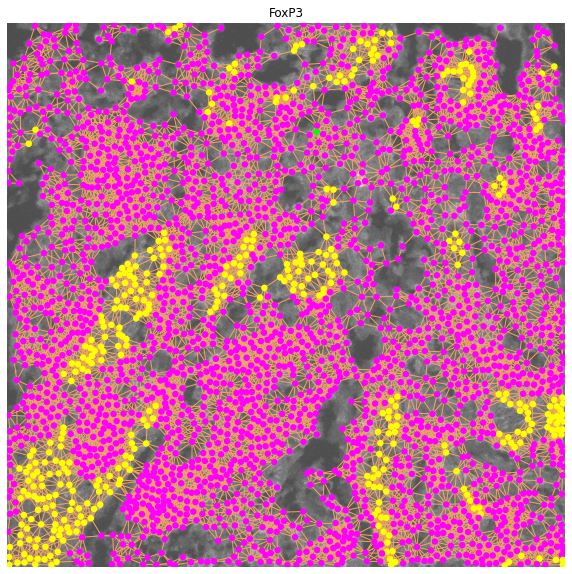

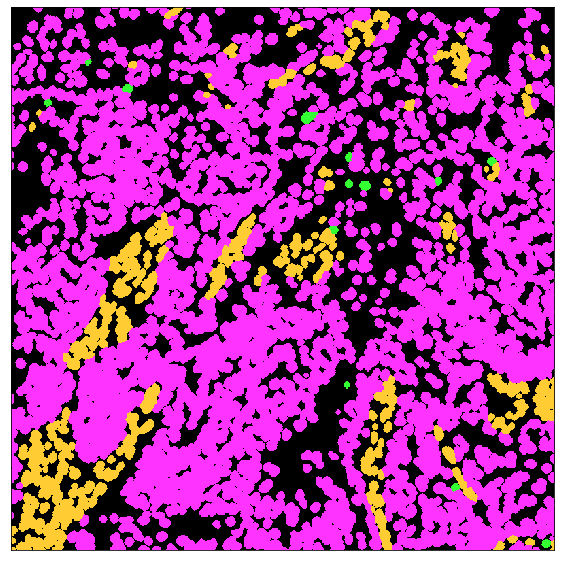

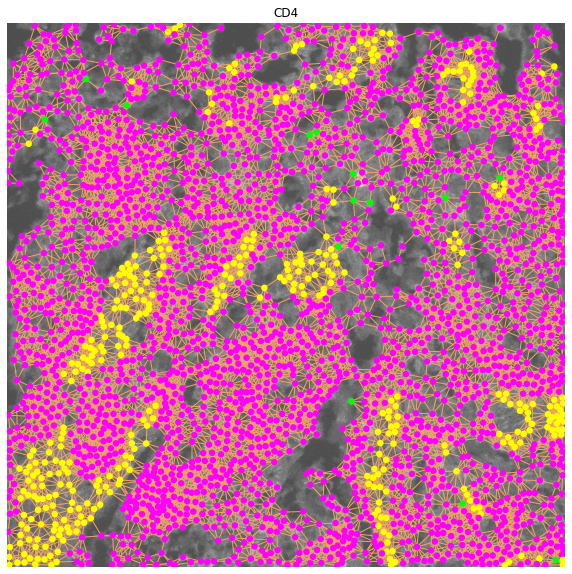

...

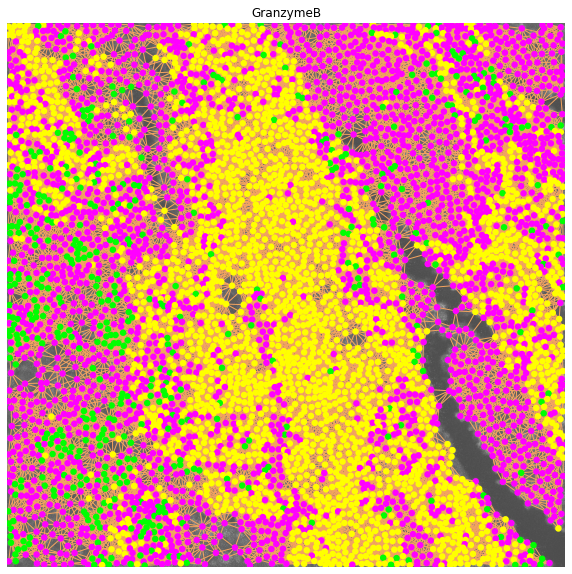

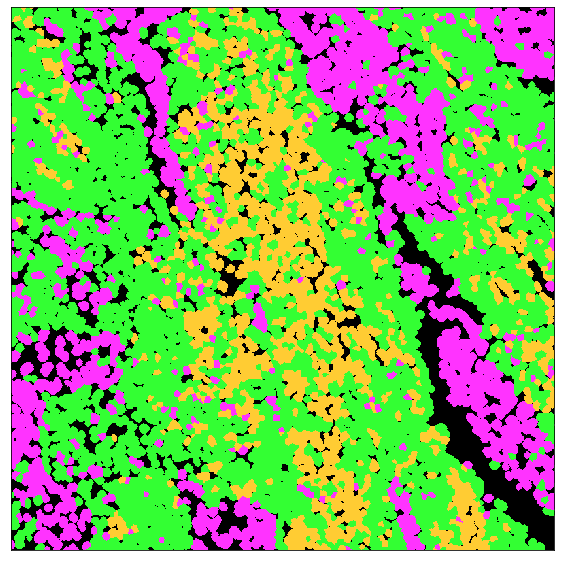

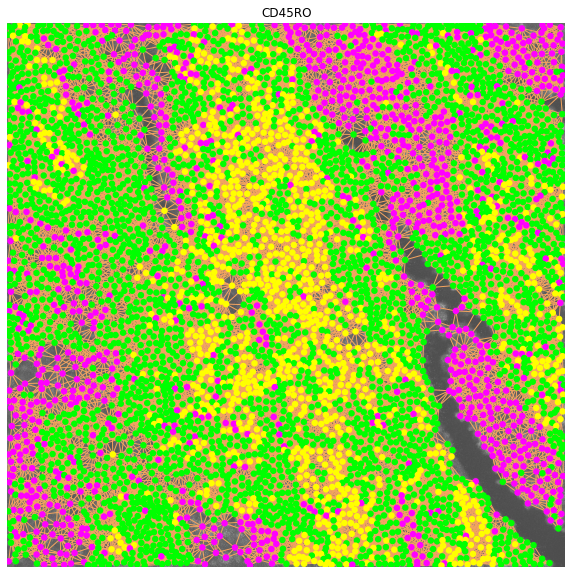

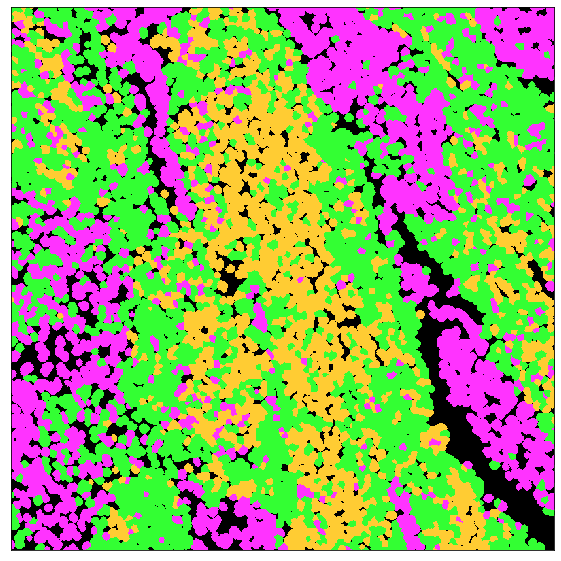

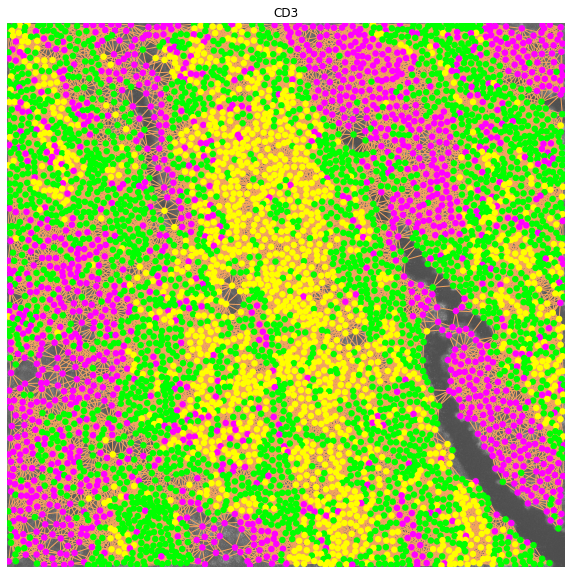

In [34]:
marker_list = [['ECadherin','PanKeratin'], ['CD68'],['CD8a'], ['Col1', 'SMA']]
labels = ['ECA+PanK', 'CD68', 'CD8a', 'Col1+SMA']
labels2 = ['ECA+PanK', 'Col1+SMA']

study_list = ['FoxP3', 'CD4', 'CD20', 'GranzymeB', 'CD45RO', 'CD3']

rgb = np.array([[255,0,255], [255,255,0], [0,255,0]])
mycmap = ListedColormap(rgb/255)
rgb2 = np.array([[255,51,255], [255,204,51], [51,255,51]])
mycmap2 = ListedColormap(rgb2/255)

show=True
n = 25

dict_row = defaultdict(list)
df_list = []

for i, dataset in enumerate(datasets):

    # Read image and cell_mask
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    cell_mask = read_cell_mask(dataset)
    min_shape = min(cell_mask.shape[0], cell_mask.shape[1])
    min_shape = myround(min_shape, base=n)
    cell_mask = cell_mask[:min_shape, :min_shape]
    
    fig1, axs = plt.subplots(2,3, figsize = (15,10))
    axs = axs.flatten()
    
    # Loop all marker() in study list
    for j, marker_study in enumerate(study_list):
        marker_list_new = marker_list + [[marker_study]]
        labels_new = labels + [marker_study]
        
        imgs_list = []
        for markers in marker_list_new:
            temp = []
            for marker in markers:
                img = marker2img[marker]
                if marker not in marker_list or marker == 'CD8a':
                    img = median(img, disk(1))
                p2, p98 = np.percentile(img, (0, 99.9))
                img = exposure.rescale_intensity(img, in_range=(p2, p98))
                temp.append(img[:min_shape, :min_shape])
            imgs_list.append(np.array(np.mean(temp, axis=(0))))

        # Grayscale backgroun image
        avg_img = np.array(np.mean(imgs, axis=(0)))[:min_shape, :min_shape]

        # Get both cell type markers and study marker images and labels
        distances, neighbors, cell_labels, graph, X = get_distances(cell_mask)
        df = get_cell_expression_level_mean(imgs_list, labels_new, cell_mask)
        df['ECA+PanK'] = df['ECA+PanK'] * 0.6

        node_class, node_colors = get_cell_color(df, labels2 + [marker_study], rgb) 
        neighbor_class = get_nei_info(cell_labels, neighbors, node_class, distances)
        node_patch = get_node_patch(X, node_class, n)
        
        #Plot cell mask
        img = replace_with_dict(cell_mask , node_class)
        fig, ax = plt.subplots(figsize=(10,10))
        ax.imshow(img, cmap=mycmap2, interpolation='None', vmin=0, vmax=3)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        ax.set_facecolor('black')
        fig.savefig(data_figure / 'border2' / f'cell_mask_{dataset}_{marker}.png', bbox_inches='tight')
        
        # Add ROI metadata        
        df['Type'] = pd.Series(node_class, index=df.index, dtype=int).astype("category").map({0:'Tumor', 1:'IN', 2:'IP',3:'Stroma'})
        df['Immune Type'] = Immune_type[i]
        df['Dataset'] = dataset
        df_list.append(df)
        
        #Plot proximity map
        fig, ax = plt.subplots(figsize=(10,10))
        ax.axis('off')
        top, right = avg_img.shape
        ax.imshow(avg_img, cmap='gray', alpha=0.7, aspect='auto', extent=[0,right,0,top], origin='lower')
        plot_nn(X, graph, node_colors, ax)
        ax.invert_yaxis()
        ax.set_title(marker_study)
        fig.savefig(data_figure / 'border2' / f'cell_graph_{dataset}_{marker}.png', bbox_inches='tight')
        
        tumor = patch_count(0, node_class, node_patch, n, avg_img.shape) 
        stroma = patch_count(1, node_class, node_patch, n, avg_img.shape)
        immune =  patch_count(2, node_class, node_patch, n, avg_img.shape)
        
        total = [patch_count(i, node_class, node_patch, n, avg_img.shape)  for i in range(5)]
        total = np.sum(total, axis=(0))
        P_tumor = np.divide(tumor, total, out=np.zeros_like(total), where=total!=0)
        P_immune = np.divide(immune, total, out=np.zeros_like(total), where=total!=0)
        P_stroma = np.divide(stroma, total, out=np.zeros_like(total), where=total!=0)
        
        immune_t_int = patch_count_neighbor(2, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
        immune_s_int = patch_count_neighbor(2, 1, neighbor_class, node_class, node_patch, n, avg_img.shape)
        immune_immune_int = patch_count_neighbor(2, 2, neighbor_class, node_class, node_patch, n, avg_img.shape)
        immune_int_total = [patch_count_neighbor(2, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
        immune_int_total = np.sum(immune_int_total, axis=(0))
        P_immune_t = np.divide(immune_t_int, immune_int_total, out=np.zeros_like(immune_int_total), where=immune_int_total!=0)
        P_immune_s = np.divide(immune_s_int, immune_int_total, out=np.zeros_like(immune_int_total), where=immune_int_total!=0)
        P_immune_immune = np.divide(immune_immune_int, immune_int_total, out=np.zeros_like(immune_int_total), where=immune_int_total!=0)
        
        dict_row['Dataset'].append(dataset)
        dict_row['Marker'].append(marker)
        dict_row['Immune Type'].append(Immune_type[i])
        dict_row['Tumor'].append(round(np.mean(P_tumor),4))
        dict_row['Stroma'].append(round(np.mean(P_stroma),4))
        dict_row['Immune'].append(round(np.mean(P_immune),4))
        dict_row['T-I'].append(round(np.mean(P_immune_t),4))
        dict_row['S-I'].append(round(np.mean(P_immune_s),4))
        dict_row['I-I'].append(round(np.mean(P_immune_immune),4))
        
        axs[j].imshow(P_immune_t, vmin=0, vmax=1, cmap='Greens')
        axs[j].tick_params(axis=u'both', which=u'both',length=0, labelbottom=False, labelleft=False)
        axs[j].text(.01,.90, marker_study, color='red', fontsize=25,
                    horizontalalignment='left',
                    transform=axs[j].transAxes)
    
    fig1.patch.set_edgecolor('black')  
    fig1.patch.set_linewidth('10') 
    fig1.subplots_adjust(hspace=0.01, wspace=0.01)   
    fig1.savefig(data_figure / 'border2' / f'immune_{dataset}.png', bbox_inches='tight')
    plt.show()
    

# Plot all info heatmap

In [35]:
df = pd.DataFrame.from_dict(dict_row)
df.head()

,Dataset,Marker,Immune Type,Tumor,Stroma,Immune,T-I,S-I,I-I
0,ROI001_B1,FoxP3,Immune Cold,0.8060,0.1263,0.0003,0.0010,0.0000,0.0000
1,ROI001_B1,CD4,Immune Cold,0.8002,0.1259,0.0065,0.0104,0.0018,0.0006
2,ROI001_B1,CD20,Immune Cold,0.8063,0.1263,0.0000,0.0000,0.0000,0.0000
3,ROI001_B1,GranzymeB,Immune Cold,0.8062,0.1256,0.0008,0.0021,0.0009,0.0000
4,ROI001_B1,CD45RO,Immune Cold,0.7864,0.1213,0.0249,0.0408,0.0107,0.0061


In [36]:
df_subset = df.drop(['Dataset'], axis=1).groupby(['Immune Type', 'Marker']).mean()
immunes = df_subset.reset_index('Immune Type')['Immune Type'].tolist()
# df_subset.drop('Immune Type', axis=1,inplace=True)

In [37]:
df_subset

Tumor   Stroma   Immune      T-I      S-I  \
Immune Type       Marker                                                   
Immune Cold       CD20       0.82620  0.11355  0.00000  0.00000  0.00000   
                  CD3        0.82280  0.11045  0.00650  0.00960  0.00340   
                  CD4        0.82315  0.11245  0.00410  0.00575  0.00135   
                  CD45RO     0.81295  0.10075  0.02605  0.03600  0.01540   
                  FoxP3      0.82605  0.11355  0.00015  0.00050  0.00000   
                  GranzymeB  0.82615  0.11310  0.00050  0.00105  0.00095   
Immune Suppressed CD20       0.60870  0.31740  0.00800  0.01530  0.01130   
                  CD3        0.48800  0.26865  0.17745  0.19025  0.12410   
                  CD4        0.44255  0.30085  0.19075  0.14435  0.08380   
                  CD45RO     0.28445  0.22485  0.42475  0.14765  0.14875   
                  FoxP3      0.58600  0.31645  0.03170  0.06470  0.02640   
                  GranzymeB  0.59320  0.31585  0.02510  0.04695  0.02105   
Immune inflamed   CD20       0.50630  0.43760  0.04345  0.06325  0.04675   
                  CD3        0.28120  0.27310  0.43300  0.16865  0.19675   
                  CD4        0.43690  0.39330  0.15705  0.14685  0.15125   
                  CD45RO     0.24545  0.23820  0.50370  0.14540  0.18065   
                  FoxP3      0.50555  0.43845  0.04335  0.09025  0.08285   
                  GranzymeB  0.45930  0.43115  0.09690  0.14105  0.09760   

                                 I-I  
Immune Type       Marker              
Immune Cold       CD20       0.00000  
                  CD3        0.00070  
                  CD4        0.00035  
                  CD45RO     0.00705  
                  FoxP3      0.00000  
                  GranzymeB  0.00000  
Immune Suppressed CD20       0.00080  
                  CD3        0.10260  
                  CD4        0.13265  
                  CD45RO     0.35545  
                  FoxP3      0.00560  
                  GranzymeB  0.00715  
Immune inflamed   CD20       0.02575  
                  CD3        0.38900  
                  CD4        0.10965  
                  CD45RO     0.46445  
                  FoxP3      0.01435  
                  GranzymeB  0.05630

In [38]:
lut = dict(zip(set(immunes), sns.hls_palette(len(set(immunes)), l=0.5, s=0.8)))
col_colors = pd.DataFrame(immunes)[0].map(lut)

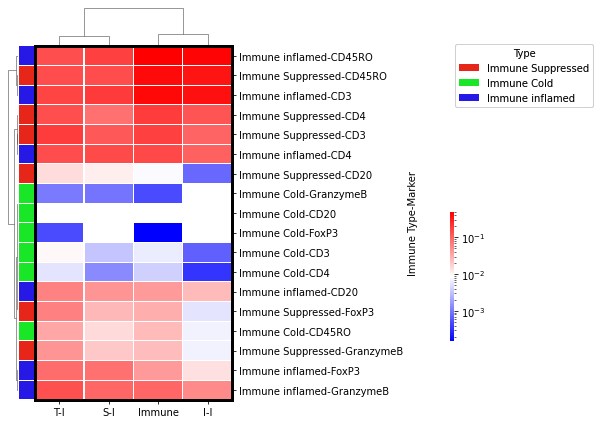

In [39]:
from matplotlib.patches import Patch
from matplotlib.colors import LogNorm

ax = sns.clustermap(df_subset.iloc[:,2:], 
                        cmap='bwr',
                        cbar_kws={"fraction": 0.01},
                        linewidth=0.1,
                        row_colors = [col_colors],
                        cbar_pos=(1.05, .2, .01, .3), 
                        dendrogram_ratio=(0.05, 0.1),
                        colors_ratio=0.07,
                        figsize=(6, 6),
                        norm=LogNorm())
# ax.ax_heatmap.set_xticklabels(ax.ax_heatmap.get_xticklabels(), rotation=30, ha='right')
ax.ax_heatmap.set_yticklabels(ax.ax_heatmap.get_yticklabels(), rotation=0)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)
    
handles = [Patch(facecolor=lut[name]) for name in lut]
lgd1 = plt.legend(handles, lut, title='Type',
           bbox_to_anchor=(1.05, 0.9), bbox_transform=plt.gcf().transFigure, loc='upper left')
plt.gca().add_artist(lgd1)

# Plot marker intensity per Cell type

In [10]:
df_appended = []
for i in range(6):
    df_sublist = df_list[i*6:(i+1)*6]
    
    df = pd.concat(df_sublist, axis=1)
    df = df.loc[:,~df.columns.duplicated()]
    df_appended.append(df)

In [11]:
df_all = pd.concat(df_appended)

In [12]:
df_all.set_index('Dataset', append=True, inplace=True)

In [13]:
df_subset = df_all[study_list]
df_filter = df_all.iloc[:, :4]
df_subset = df_subset.loc[
    (df_filter.idxmax(axis=1) == 'CD68') | 
    (df_filter.idxmax(axis=1) == 'CD8a'), 
]

In [14]:
df_subset

,,FoxP3,CD4,CD20,GranzymeB,CD45RO,CD3
label,Dataset,,,,,,
1,ROI001_B1,0.000000,0.000000,0.000000,11.828571,96.371429,4.885714
4,ROI001_B1,19.600000,17.020000,0.000000,11.300000,70.900000,27.720000
14,ROI001_B1,19.833333,45.474359,0.000000,12.192308,100.641026,66.858974
18,ROI001_B1,3.239669,2.033058,0.000000,0.000000,76.867769,12.446281
21,ROI001_B1,9.495238,13.523810,0.000000,3.561905,131.628571,6.514286
...,...,...,...,...,...,...,...
5629,ROI016_F3,0.000000,17.788462,0.000000,47.230769,82.250000,76.384615
5630,ROI016_F3,0.000000,0.000000,5.297297,5.027027,100.189189,38.864865
5634,ROI016_F3,5.880597,14.552239,0.000000,52.492537,113.089552,88.298507


In [15]:
scaler = StandardScaler()
x_scaled = scaler.fit_transform(np.log(df_subset+0.1))
x_scaled = scaler.fit_transform(x_scaled.T).T
df_exp = pd.DataFrame(
    x_scaled, columns=df_subset.columns
)

df_exp

,FoxP3,CD4,CD20,GranzymeB,CD45RO,CD3
0,-0.938044,-1.311144,0.078577,1.154280,1.387363,-0.371032
1,1.266115,0.309870,-1.844506,0.793815,-0.007086,-0.518207
2,0.513857,0.602660,-2.160510,0.176744,0.819403,0.047846
3,0.701428,-0.118378,-0.040479,-1.936547,1.317692,0.076284
4,0.428117,0.180012,-0.902586,-0.184042,1.791876,-1.313377
...,...,...,...,...,...,...
8860,-1.834372,0.290454,-0.695254,1.256626,0.438680,0.543867
8861,-1.189931,-1.528841,1.001354,0.339853,0.988495,0.389071
8862,-0.478859,-0.379078,-1.703774,1.293615,0.985240,0.282856
8863,-2.058082,0.521843,-0.435401,0.620871,0.627260,0.723510


In [16]:
import parc

X = df_exp.values
parc1 = parc.PARC(X, jac_weighted_edges = False, random_seed=0)
parc1.run_PARC() 
parc_labels = parc1.labels

graph = parc1.knngraph_full()
embeddings = parc1.run_umap_hnsw(X, graph, random_state = 1)

input data has shape 8865 (samples) x 6 (features)
knn struct was not available, so making one
commencing local pruning based on Euclidean distance metric at 3 s.dev above mean
commencing global pruning
commencing community detection
partition type MVP
list of cluster labels and populations 27 [(0, 593), (1, 577), (2, 505), (3, 428), (4, 417), (5, 385), (6, 375), (7, 372), (8, 363), (9, 352), (10, 347), (11, 330), (12, 320), (13, 313), (14, 299), (15, 289), (16, 290), (17, 287), (18, 277), (19, 274), (20, 254), (21, 242), (22, 228), (23, 220), (24, 204), (25, 184), (26, 140)]
time elapsed 6.9 seconds
a,b, spread, dist 1.5769434603935901 0.8950608781603765 1.0 0.1
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs


Text(0, 0.5, 'Umap 2')

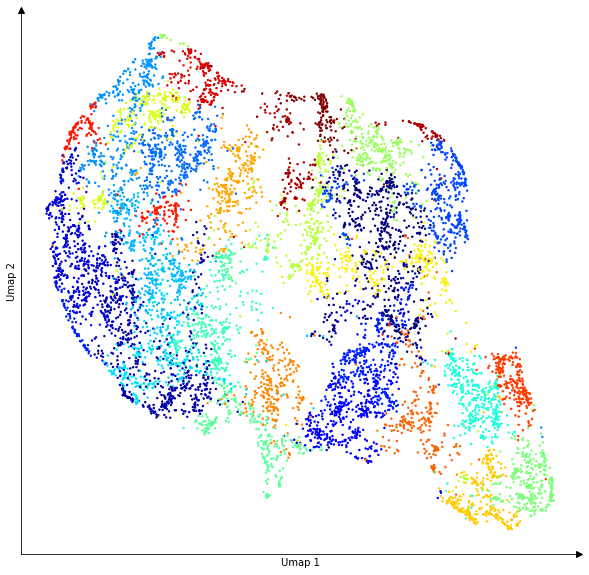

In [17]:
name = 'Umap'

fig, ax = plt.subplots(figsize=(10, 10))
X, Y = embeddings[:, 0], embeddings[:, 1]
ax.scatter(X, Y, c=parc_labels, s=2, cmap='jet')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(axis='both', which='both', bottom=False, left=False, labelbottom=False, labelleft=False)

# Add arrow with spine
pos = ax.get_position()
ax.plot(pos.x1, pos.y0, ">k", transform=fig.transFigure, clip_on=False)
ax.plot(pos.x0, pos.y1, "^k", transform=fig.transFigure, clip_on=False)

# Add label
ax.set_xlabel(f'{name} 1')
ax.set_ylabel(f'{name} 2')

In [18]:
df_exp["cluster_label"] = parc_labels

# Get dataframe per cluster
df_per_label = df_exp.groupby("cluster_label").mean()
df_per_label.head()

,FoxP3,CD4,CD20,GranzymeB,CD45RO,CD3
cluster_label,,,,,,
0,0.359689,-1.497288,1.305827,-0.329168,-0.017541,0.178481
1,0.676883,1.461260,-0.645945,-0.612256,-0.048319,-0.831623
2,0.638568,0.775742,-1.349449,-1.087758,0.684015,0.338882
3,0.099189,0.148563,1.652709,-1.238765,-0.328666,-0.333029
4,0.348697,0.020785,0.158747,-1.738219,0.933009,0.276981


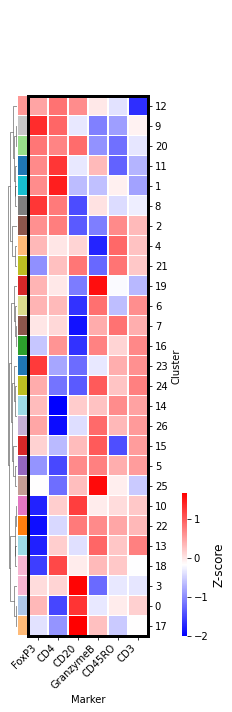

In [19]:
import matplotlib

def create_HM(df_per_label, my_cmap, row_colors, scale_name, cellSizePixels=20, **kwargs):
    # Calulate the figure size, this gets us close, but not quite to the right place
    dpi = matplotlib.rcParams['figure.dpi']
    marginWidth = matplotlib.rcParams['figure.subplot.right']-matplotlib.rcParams['figure.subplot.left']
    marginHeight = matplotlib.rcParams['figure.subplot.top']-matplotlib.rcParams['figure.subplot.bottom']
    Ny,Nx = df_per_label.shape
    figWidth = (Nx*cellSizePixels/dpi)/marginWidth
    figHeigh = (Ny*cellSizePixels/dpi)/marginHeight
    
    ax = sns.clustermap(df_per_label,
                        cmap=my_cmap,
                        linewidth=0.5,
                        col_cluster=False,
                        row_colors=[row_colors],
                        colors_ratio=0.1,
                        dendrogram_ratio=(.1, 0.0),
                        figsize=(figWidth, figHeigh),
                        **kwargs
                        )
    ax.ax_heatmap.set_yticklabels(
        ax.ax_heatmap.get_yticklabels(), rotation=0)
    ax.ax_heatmap.set_xticklabels(
        ax.ax_heatmap.get_xticklabels(), rotation=45, horizontalalignment='right')
    ax.ax_heatmap.set_xlabel('Marker')
    ax.ax_heatmap.set_ylabel('Cluster')
    
    # calculate the size of the heatmap axes
    axWidth = (Nx*cellSizePixels)/(figWidth*dpi)
    axHeight = (Ny*cellSizePixels)/(figHeigh*dpi)

    # resize heatmap
    ax_heatmap_orig_pos = ax.ax_heatmap.get_position()
    ax.ax_heatmap.set_position([ax_heatmap_orig_pos.x0, ax_heatmap_orig_pos.y0, 
                                  axWidth, axHeight])

    # resize dendrograms to match
    ax_row_orig_pos = ax.ax_row_dendrogram.get_position()
    ax.ax_row_dendrogram.set_position([ax_row_orig_pos.x0, ax_row_orig_pos.y0, 
                                         ax_row_orig_pos.width, axHeight])
    ax_row_orig_pos = ax.ax_row_colors.get_position()
    ax.ax_row_colors.set_position([ax_row_orig_pos.x0, ax_row_orig_pos.y0, 
                                         ax_row_orig_pos.width, axHeight])

    pos = ax.ax_heatmap.get_position()
    cbar_size=0.2
    ax.ax_cbar.set_position((1.2, pos.y0, .03, cbar_size))
    
    # Change colorbar label position
    cbar = ax.ax_heatmap.collections[0].colorbar
    cbar.set_label(scale_name, fontsize=12)

    for _, spine in ax.ax_heatmap.spines.items():
        spine.set_visible(True)
        spine.set_linewidth(3)
        
def create_umap(embeddings, labels, cmap):
    fig, ax = plt.subplots(figsize=(10, 10))
    X, Y = embeddings[:, 0], embeddings[:, 1]
    ax.scatter(X, Y, c=labels, s= 2, vmin=0, cmap= matplotlib.colors.ListedColormap(cmap))
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.tick_params(axis='both', which='both', bottom=False, left=False, labelbottom=False, labelleft=False)

    # Add arrow with spine
    pos = ax.get_position()
    ax.plot(pos.x1, pos.y0, ">k", transform=fig.transFigure, clip_on=False)
    ax.plot(pos.x0, pos.y1, "^k", transform=fig.transFigure, clip_on=False)

    # Add label
    ax.set_xlabel(f'Umap 1')
    ax.set_ylabel(f'Umap 2')

my_cmap = "bwr"
scale_name = "Z-score"

# my_cmap = "viridis"
# scale_name = "Normalized Expression"

# Get linkage
d = sch.distance.pdist(df_per_label, metric='cosine')
L = sch.linkage(d, method="average")

# Get colormap
vals = np.linspace(0, 1, len(df_per_label))
np.random.seed(0)
np.random.shuffle(vals)
my_cmap_row = plt.cm.tab20(vals)

# Clustermap and umap
labels = df_per_label.index.to_list()
my_cmap_dict = dict(zip(labels, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)
create_HM(df_per_label, my_cmap, row_colors, scale_name, row_linkage=L)


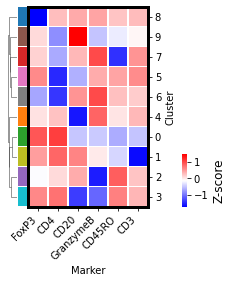

In [20]:
tol = 0.25

# Get colormap
vals = np.linspace(0, 1, len(df_per_label))
np.random.seed(0)
np.random.shuffle(vals)
my_cmap_row = plt.cm.tab20(vals)


# Clustermap and umap
labels = df_per_label.index.to_list()
my_cmap_dict = dict(zip(labels, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)

# Merge similar cluster
clusters = sch.fcluster(L, tol * d.max(), "distance")-1
clusters_unique = np.unique(clusters)
n_clusters = len(np.unique(clusters))

# Clustermap and umap
label2cluster = dict(zip(labels, clusters))
result = defaultdict(int)
for k, v in zip(clusters, labels):
    result[k] = max(result[k], v)
row_colors = pd.DataFrame(labels)[0].map(label2cluster).map(result).map(my_cmap_dict)
clusters = np.array(list(map(label2cluster.get, parc_labels)))
new_parc_labels = np.array(list(map(result.get, clusters)))

# Clustermap and umap with new colormap
vals = np.linspace(0, 1, n_clusters)
np.random.seed(0)
np.random.shuffle(vals)
my_cmap_row = plt.cm.tab10(vals)
my_cmap_dict = dict(zip(clusters_unique, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(label2cluster).map(my_cmap_dict)
new_parc_labels = np.array(list(map(label2cluster.get, parc_labels)))

# Combined 
df_combined = df_exp.copy()
df_combined.cluster_label = df_combined.cluster_label.map(label2cluster.get)
df_combined.cluster_label.astype(int)
df_combined = df_combined.groupby("cluster_label").mean()
labels = df_combined.index.to_list()

row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)

create_HM(df_combined, my_cmap, row_colors, scale_name, cellSizePixels=20)

# Plot cell mask

In [21]:
df_exp.cluster_label = df_exp.cluster_label.map(label2cluster.get)
df_exp

,FoxP3,CD4,CD20,GranzymeB,CD45RO,CD3,cluster_label
0,-0.938044,-1.311144,0.078577,1.154280,1.387363,-0.371032,6
1,1.266115,0.309870,-1.844506,0.793815,-0.007086,-0.518207,0
2,0.513857,0.602660,-2.160510,0.176744,0.819403,0.047846,4
3,0.701428,-0.118378,-0.040479,-1.936547,1.317692,0.076284,2
4,0.428117,0.180012,-0.902586,-0.184042,1.791876,-1.313377,0
...,...,...,...,...,...,...,...
8860,-1.834372,0.290454,-0.695254,1.256626,0.438680,0.543867,8
8861,-1.189931,-1.528841,1.001354,0.339853,0.988495,0.389071,6
8862,-0.478859,-0.379078,-1.703774,1.293615,0.985240,0.282856,4
8863,-2.058082,0.521843,-0.435401,0.620871,0.627260,0.723510,8


In [22]:
df_exp.index = df_subset.index
df_exp.reset_index(inplace=True)
df_exp

,label,Dataset,FoxP3,CD4,CD20,GranzymeB,CD45RO,CD3,cluster_label
0,1,ROI001_B1,-0.938044,-1.311144,0.078577,1.154280,1.387363,-0.371032,6
1,4,ROI001_B1,1.266115,0.309870,-1.844506,0.793815,-0.007086,-0.518207,0
2,14,ROI001_B1,0.513857,0.602660,-2.160510,0.176744,0.819403,0.047846,4
3,18,ROI001_B1,0.701428,-0.118378,-0.040479,-1.936547,1.317692,0.076284,2
4,21,ROI001_B1,0.428117,0.180012,-0.902586,-0.184042,1.791876,-1.313377,0
...,...,...,...,...,...,...,...,...,...
8860,5629,ROI016_F3,-1.834372,0.290454,-0.695254,1.256626,0.438680,0.543867,8
8861,5630,ROI016_F3,-1.189931,-1.528841,1.001354,0.339853,0.988495,0.389071,6
8862,5634,ROI016_F3,-0.478859,-0.379078,-1.703774,1.293615,0.985240,0.282856,4
8863,5635,ROI016_F3,-2.058082,0.521843,-0.435401,0.620871,0.627260,0.723510,8


In [23]:

def create_cell_img(cell_mask, df_subset, img_dna, my_cmap_row):
    img = np.zeros((cell_mask.shape[0], cell_mask.shape[1], 4), dtype=np.uint8) * np.NaN

    rows, cols = np.where(cell_mask>0)
    img[rows, cols, :] = [88/255,88/255,88/255,0.8]

    cell_label = df_subset.label.tolist()
    cluster_label = np.array(df_subset.cluster_label.tolist())
    for i, cell_id in enumerate(cell_label):
        rows, cols = np.where(cell_mask == cell_id)
        img[rows, cols, :] = my_cmap_row[cluster_label[i]]
        
    fig, ax = plt.subplots(figsize=(10.,10))
#     ax.imshow(img_dna, cmap='gray', alpha=0.8)
    ax.imshow(img, interpolation='None')
    fig.set_facecolor("k")
    ax.axis("off")

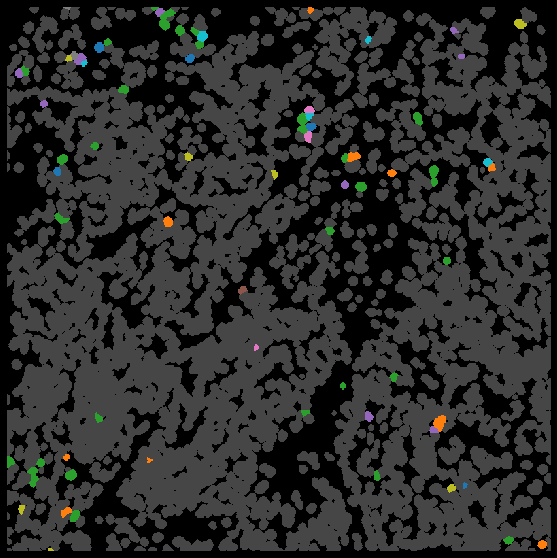

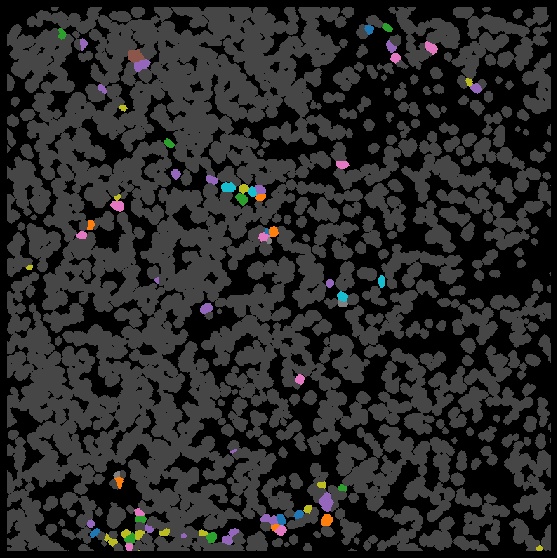

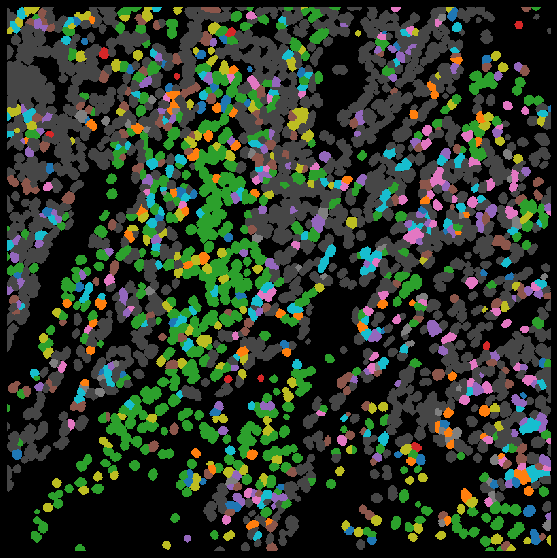

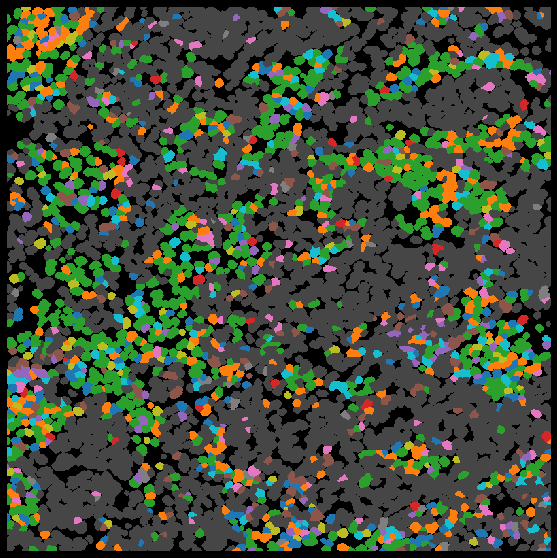

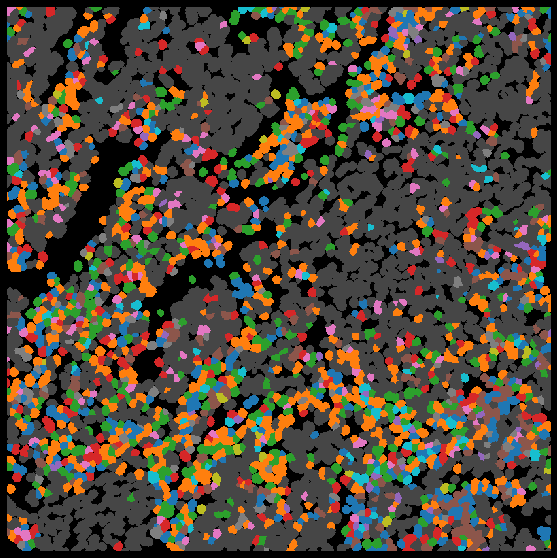

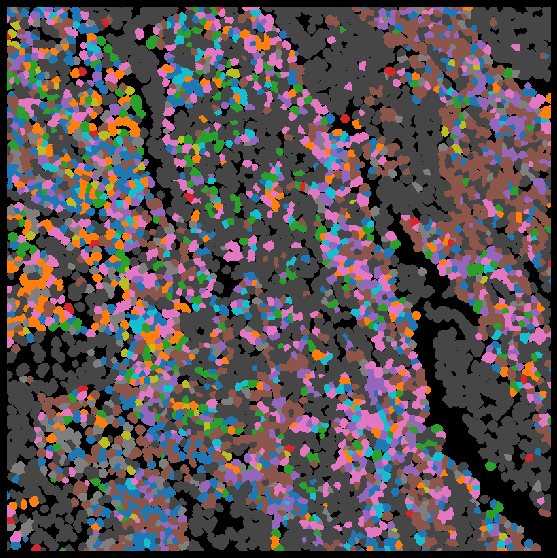

In [24]:
for dataset in datasets:
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    
    cell_mask = read_cell_mask(dataset)
    min_shape = min(cell_mask.shape[0], cell_mask.shape[1])
    min_shape = myround(min_shape, base=n)
    cell_mask = cell_mask[:min_shape, :min_shape]
    
    df_subset = df_exp[df_exp.Dataset == dataset]
    create_cell_img(cell_mask, df_subset, marker2img['DNA1'], my_cmap_row)
    